# Bank Loan Prediction

### The goal of this notebook is to develop a model to predict whether the customer is eligible for bank loan or not 

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import copy
%matplotlib inline

### Read in Data

In [3]:
os.listdir()

['Analysis.ipynb', 'credit_train.csv']

In [4]:
main_df = pd.read_csv('credit_train.csv')
main_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100514 entries, 0 to 100513
Data columns (total 19 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   Loan ID                       100000 non-null  object 
 1   Customer ID                   100000 non-null  object 
 2   Loan Status                   100000 non-null  object 
 3   Current Loan Amount           100000 non-null  float64
 4   Term                          100000 non-null  object 
 5   Credit Score                  80846 non-null   float64
 6   Annual Income                 80846 non-null   float64
 7   Years in current job          95778 non-null   object 
 8   Home Ownership                100000 non-null  object 
 9   Purpose                       100000 non-null  object 
 10  Monthly Debt                  100000 non-null  float64
 11  Years of Credit History       100000 non-null  float64
 12  Months since last delinquent  46859 non-null

In [5]:
# Drop rows and column with small/large missing values
main_df = main_df[main_df['Tax Liens'].isna() == False]
main_df = main_df[main_df['Bankruptcies'].isna() == False]
main_df = main_df[main_df['Maximum Open Credit'].isna() == False]
main_df = main_df[main_df['Years in current job'].isna() == False]
main_df.drop(['Loan ID', 'Customer ID', 'Months since last delinquent'], axis=1, inplace=True)
main_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 95572 entries, 0 to 99998
Data columns (total 16 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Loan Status                95572 non-null  object 
 1   Current Loan Amount        95572 non-null  float64
 2   Term                       95572 non-null  object 
 3   Credit Score               77271 non-null  float64
 4   Annual Income              77271 non-null  float64
 5   Years in current job       95572 non-null  object 
 6   Home Ownership             95572 non-null  object 
 7   Purpose                    95572 non-null  object 
 8   Monthly Debt               95572 non-null  float64
 9   Years of Credit History    95572 non-null  float64
 10  Number of Open Accounts    95572 non-null  float64
 11  Number of Credit Problems  95572 non-null  float64
 12  Current Credit Balance     95572 non-null  float64
 13  Maximum Open Credit        95572 non-null  flo

In [6]:
main_df.describe()

,Current Loan Amount,Credit Score,Annual Income,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
count,9.557200e+04,77271.000000,7.727100e+04,95572.000000,95572.000000,95572.000000,95572.000000,9.557200e+04,9.557200e+04,95572.000000,95572.000000
mean,1.181934e+07,1071.759392,1.399186e+06,18717.742129,17.994267,11.185211,0.162589,2.969752e+05,7.606075e+05,0.113046,0.028460
std,3.185015e+07,1466.273187,1.094465e+06,12228.627101,6.803336,5.017998,0.474728,3.781783e+05,8.507373e+06,0.344686,0.254755
min,1.542200e+04,585.000000,7.662700e+04,0.000000,3.600000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,1.840520e+05,705.000000,8.625050e+05,10456.650000,13.400000,8.000000,0.000000,1.143752e+05,2.762980e+05,0.000000,0.000000
50%,3.172840e+05,724.000000,1.202263e+06,16450.295000,16.800000,10.000000,0.000000,2.121350e+05,4.712730e+05,0.000000,0.000000
75%,5.289460e+05,741.000000,1.677339e+06,24265.565000,21.500000,14.000000,0.000000,3.710510e+05,7.867970e+05,0.000000,0.000000
max,1.000000e+08,7510.000000,1.655574e+08,435843.280000,70.500000,76.000000,15.000000,3.287897e+07,1.539738e+09,7.000000,15.000000


In [7]:
main_df.head(5)

,Loan Status,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
0,Fully Paid,445412.0,Short Term,709.0,1167493.0,8 years,Home Mortgage,Home Improvements,5214.74,17.2,6.0,1.0,228190.0,416746.0,1.0,0.0
1,Fully Paid,262328.0,Short Term,NaN,NaN,10+ years,Home Mortgage,Debt Consolidation,33295.98,21.1,35.0,0.0,229976.0,850784.0,0.0,0.0
2,Fully Paid,99999999.0,Short Term,741.0,2231892.0,8 years,Own Home,Debt Consolidation,29200.53,14.9,18.0,1.0,297996.0,750090.0,0.0,0.0
3,Fully Paid,347666.0,Long Term,721.0,806949.0,3 years,Own Home,Debt Consolidation,8741.90,12.0,9.0,0.0,256329.0,386958.0,0.0,0.0
4,Fully Paid,176220.0,Short Term,NaN,NaN,5 years,Rent,Debt Consolidation,20639.70,6.1,15.0,0.0,253460.0,427174.0,0.0,0.0


### 'Loan Status' is the target column. Let's visualise the target column.

In [8]:
main_df['Loan Status'].value_counts()

Fully Paid     74257
Charged Off    21315
Name: Loan Status, dtype: int64

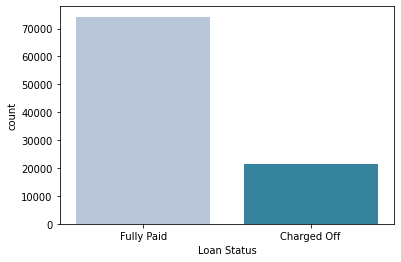

In [9]:
sns.countplot(main_df['Loan Status'], palette='PuBuGn')

### We see that the target variable is imbalanced. This may adversely affect our model. In order to deal with imbalanced dataset, we will use some form of sampling technique later in this notebook.

### We also noticed some missing values. Apart from that, few of the columns are categorical while others are continous. Let's get counts of each category for the categorical columns.

In [10]:
main_df['Term'].unique()

array(['Short Term', 'Long Term'], dtype=object)

In [11]:
main_df['Years in current job'].unique()

array(['8 years', '10+ years', '3 years', '5 years', '< 1 year',
       '2 years', '4 years', '9 years', '7 years', '1 year', '6 years'],
      dtype=object)

In [12]:
main_df['Home Ownership'].unique()

array(['Home Mortgage', 'Own Home', 'Rent', 'HaveMortgage'], dtype=object)

In [13]:
main_df['Purpose'].unique()

array(['Home Improvements', 'Debt Consolidation', 'Buy House',
       'Business Loan', 'Buy a Car', 'other', 'major_purchase',
       'Take a Trip', 'Other', 'small_business', 'Medical Bills',
       'wedding', 'vacation', 'Educational Expenses', 'moving',
       'renewable_energy'], dtype=object)

### Before proceeding, we will split the data into train and test and then convert the entire dataframes to numeric. We will leverage sklearn for label encoding and then store all the encoders with the help of pickle library.

In [14]:
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder
from sklearn.model_selection import train_test_split

y = main_df['Loan Status']
X = main_df.drop('Loan Status', axis=1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [15]:
# Defining the nominal and ordinal categorical variables
nominalVariables = ['Loan Status', 'Term', 'Home Ownership']
OrdinalVaraibles = ['Years in current job']

In [16]:
# Define label encoders
le_loan_status = LabelEncoder()
le_term = LabelEncoder()
le_home_ownership = LabelEncoder()
le_purpose = LabelEncoder()

# Define ordinal encoders
oe_years_job = OrdinalEncoder()

In [17]:
# Transforming Data
X_train = X_train.reset_index().drop('index', axis=1)

y_train = le_loan_status.fit_transform(y_train)
X_train['Term'] = le_term.fit_transform(X_train['Term']).astype(int).astype(str)
X_train['Home Ownership'] = le_home_ownership.fit_transform(X_train['Home Ownership']).astype(int).astype(str)
X_train['Purpose'] = le_purpose.fit_transform(X_train['Purpose']).astype(int).astype(str)
X_train['Years in current job'] = oe_years_job.fit_transform(X_train['Years in current job'].values.reshape(-1,1)).astype(int).astype(str)
X_train['Number of Open Accounts'] = X_train['Number of Open Accounts'].astype(int).astype(str)
X_train['Number of Credit Problems'] = X_train['Number of Credit Problems'].astype(int).astype(str)
X_train['Bankruptcies'] = X_train['Bankruptcies'].astype(int).astype(str)
X_train['Tax Liens'] = X_train['Tax Liens'].astype(int).astype(str)

In [18]:
X_train.head()

,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
0,99999999.0,1,748.0,1517112.0,1,3,3,18205.42,13.3,16,1,214757.0,647592.0,1,0
1,615252.0,0,7090.0,1461252.0,8,1,3,17291.52,13.9,7,0,43776.0,72116.0,0,0
2,212696.0,1,729.0,1435127.0,10,1,3,22842.37,14.0,9,1,134007.0,425084.0,0,1
3,97834.0,1,743.0,1216798.0,1,1,2,8375.58,26.4,6,0,280421.0,343596.0,0,0
4,67166.0,1,NaN,NaN,8,3,3,21388.11,15.7,7,1,124602.0,369930.0,0,0


In [19]:
# Impute missing values based on median
X_train['Credit Score'] = X_train['Credit Score'].fillna(X_train['Credit Score'].median())
X_train['Annual Income'] = X_train['Annual Income'].fillna(X_train['Annual Income'].median())

In [20]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 76457 entries, 0 to 76456
Data columns (total 15 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Current Loan Amount        76457 non-null  float64
 1   Term                       76457 non-null  object 
 2   Credit Score               76457 non-null  float64
 3   Annual Income              76457 non-null  float64
 4   Years in current job       76457 non-null  object 
 5   Home Ownership             76457 non-null  object 
 6   Purpose                    76457 non-null  object 
 7   Monthly Debt               76457 non-null  float64
 8   Years of Credit History    76457 non-null  float64
 9   Number of Open Accounts    76457 non-null  object 
 10  Number of Credit Problems  76457 non-null  object 
 11  Current Credit Balance     76457 non-null  float64
 12  Maximum Open Credit        76457 non-null  float64
 13  Bankruptcies               76457 non-null  obj

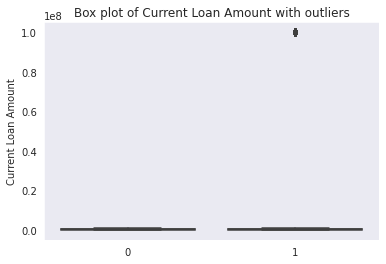

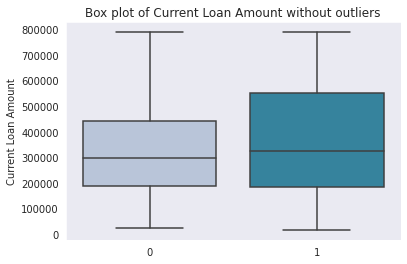

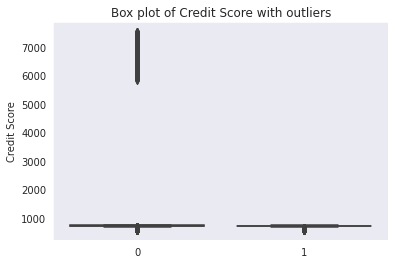

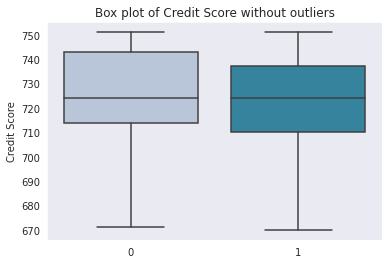

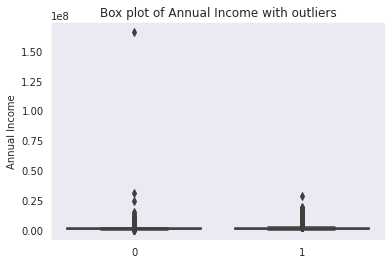

...

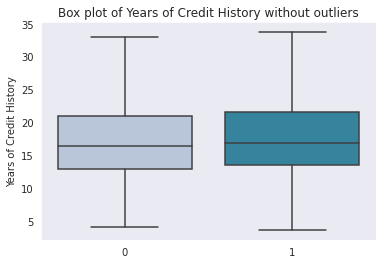

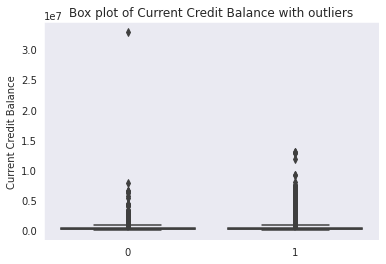

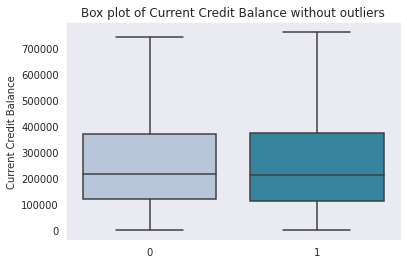

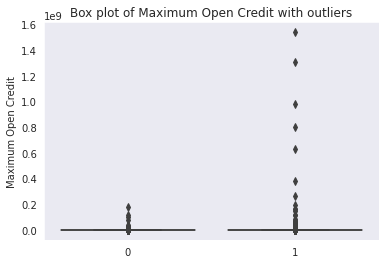

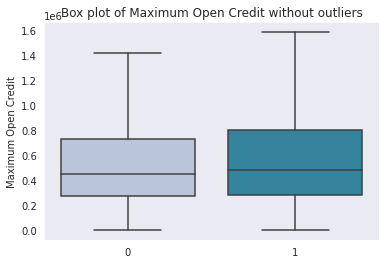

In [21]:
continous_cols = ['Current Loan Amount', 'Credit Score', 'Annual Income','Monthly Debt',
       'Years of Credit History', 'Current Credit Balance','Maximum Open Credit']

sns.set_style('dark')
for col in list(continous_cols):
    sns.boxplot(y_train, col, data=X_train, palette='PuBuGn').set_title('Box plot of ' + col + ' with outliers')
    plt.show()
    sns.boxplot(y_train, col, data=X_train, showfliers=False, palette='PuBuGn').set_title('Box plot of ' + col + ' without outliers')
    plt.show()
    print()

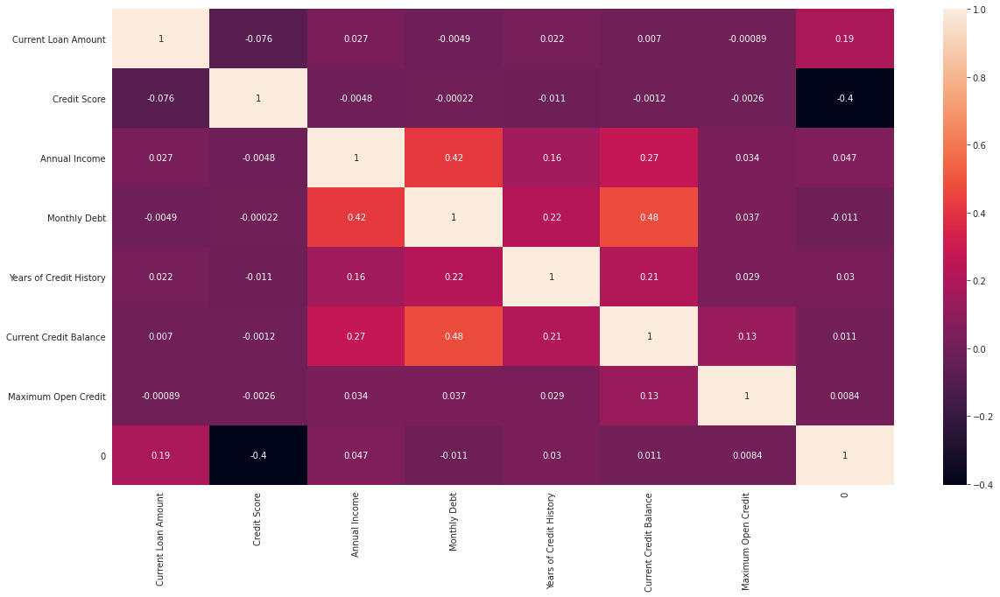

In [22]:
plt.figure(figsize=(20,10))
sns.heatmap(pd.concat([X_train,pd.DataFrame(y_train)], axis=1).corr(), annot=True)


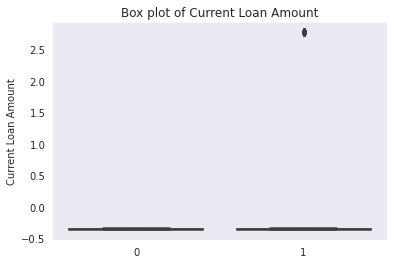

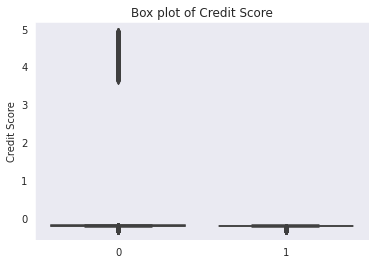

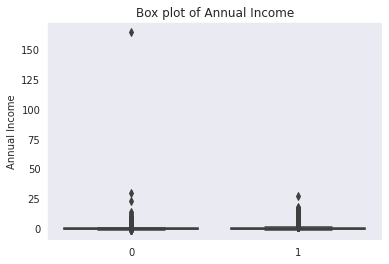

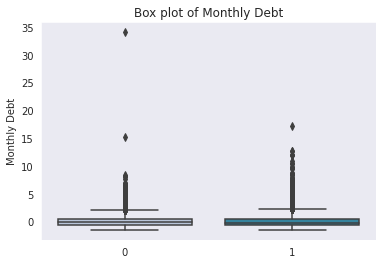

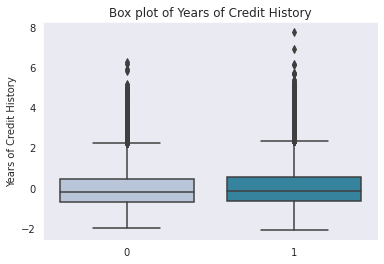

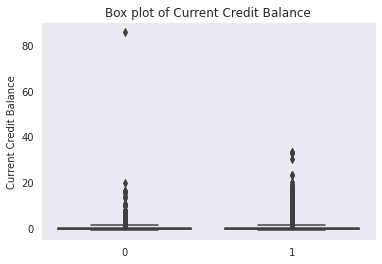

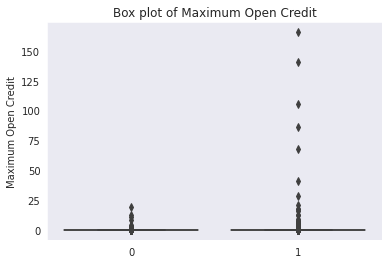

In [23]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train_sc = copy.deepcopy(X_train) 
for col in continous_cols:
    X_train_sc[col] = pd.Series(sc.fit_transform(X_train_sc[col].values.reshape(-1,1)).flatten())

sns.set_style('dark')
for col in continous_cols:
    sns.boxplot(y_train, col, data=X_train_sc, palette='PuBuGn').set_title('Box plot of ' + col)
    plt.show()
    print()


In [24]:
# Select best features
from sklearn.linear_model import Lasso
from sklearn.feature_selection import SelectFromModel
sel_ = SelectFromModel(Lasso(alpha=0.005, random_state=0))
sel_.fit(X_train_sc, y_train)

SelectFromModel(estimator=Lasso(alpha=0.005, copy_X=True, fit_intercept=True,
                                max_iter=1000, normalize=False, positive=False,
                                precompute=False, random_state=0,
                                selection='cyclic', tol=0.0001,
                                warm_start=False),
                max_features=None, norm_order=1, prefit=False, threshold=None)

In [25]:
selected_columns = X_train.columns[sel_.get_support()]
selected_columns

Index(['Current Loan Amount', 'Term', 'Credit Score', 'Annual Income',
       'Years in current job', 'Home Ownership', 'Purpose', 'Monthly Debt',
       'Years of Credit History', 'Number of Open Accounts'],
      dtype='object')

In [26]:
X_train_sc = X_train_sc[selected_columns]

### We know that the dataset is imbalanced. First approach would be to apply random forest while second approach would be to either undersample or oversample data and then apply Random Forest. Another approach would be consider KNN algorithm.Before moving ahead, we would need to mimic all the operations performed on train data on to the test data. We will also be rewriting our code using OOPS approach when building the pipeline. This will greatly help in deployment of our model via REST API.

In [27]:
selected_continous_cols = ['Current Loan Amount', 'Credit Score', 'Annual Income',
       'Monthly Debt', 'Years of Credit History']

# Transform data using encoders
X_test = X_test.reset_index().drop('index', axis=1)
X_test = X_test[selected_columns]
y_test = le_loan_status.transform(y_test)
X_test['Term'] = le_term.transform(X_test['Term']).astype(int).astype(str)
X_test['Home Ownership'] = le_home_ownership.transform(X_test['Home Ownership']).astype(int).astype(str)
X_test['Purpose'] = le_purpose.transform(X_test['Purpose']).astype(int).astype(str)
X_test['Years in current job'] = oe_years_job.transform(X_test['Years in current job'].values.reshape(-1,1)).astype(int).astype(str)
X_test['Number of Open Accounts'] = X_test['Number of Open Accounts'].astype(int).astype(str)

# Imputation median
X_test['Credit Score'] = X_test['Credit Score'].fillna(X_test['Credit Score'].median())
X_test['Annual Income'] = X_test['Annual Income'].fillna(X_test['Annual Income'].median())

# Standardisation
X_test_sc = copy.deepcopy(X_test) 
for col in selected_continous_cols:
    X_test_sc[col] = pd.Series(sc.transform(X_test_sc[col].values.reshape(-1,1)).flatten())

In [28]:
X_train_sc.head()

,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts
0,2.774874,1,-0.194037,0.157006,1,3,3,-0.040576,-0.687559,16
1,-0.350942,0,4.588973,0.101226,8,1,3,-0.115212,-0.599296,7
2,-0.363603,1,-0.208367,0.075138,10,1,3,0.338117,-0.584585,9
3,-0.367216,1,-0.197808,-0.142879,1,1,2,-0.843363,1.239519,6
4,-0.368180,1,-0.212138,-0.155325,8,3,3,0.219349,-0.334506,7


In [29]:
X_test_sc.head()

,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Number of Open Accounts
0,-0.034719,1,-0.082927,0.045598,7,1,3,-0.077809,-0.083002,19
1,-0.032294,1,-0.082927,0.045598,5,1,3,-0.080963,-0.083003,8
2,-0.036045,0,-0.082926,0.065026,1,1,5,-0.080167,-0.083001,10
3,-0.056679,0,-0.082929,-0.025001,10,1,3,-0.081758,-0.083003,5
4,-0.005395,1,-0.082927,0.093067,1,1,3,-0.079146,-0.083003,14


### Technique 1 - Random Forest & KNN

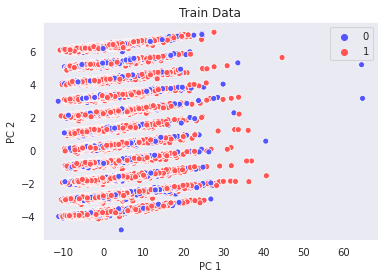

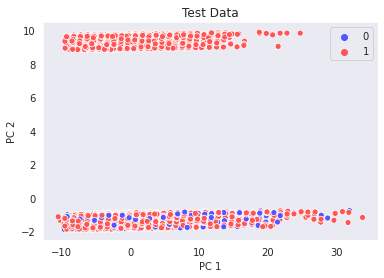

In [30]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca_train_df = pca.fit_transform(X_train_sc)
pca_test_df = pca.fit_transform(X_test_sc)
sns.scatterplot(x=pca_train_df[:,0], y=pca_train_df[:,1], hue=y_train, palette='seismic').set(title='Train Data', xlabel="PC 1", ylabel = "PC 2")
plt.show()
sns.scatterplot(x=pca_test_df[:,0], y=pca_test_df[:,1], hue=y_test, palette='seismic').set(title='Test Data', xlabel="PC 1", ylabel = "PC 2")
plt.show()

In [31]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve, precision_score, recall_score, f1_score, plot_confusion_matrix

In [32]:
rfc = RandomForestClassifier(random_state=42, max_depth=10)
rfc.fit(X_train_sc, y_train)
# pred_train = rfc.predict(X_train_sc)
pred_test = rfc.predict(X_test_sc)

Accuracy Score: 0.7769814281977505
Precision Score: 0.7769814281977505
Recall Score: 1.0
F1 Score: 0.8744958341920099


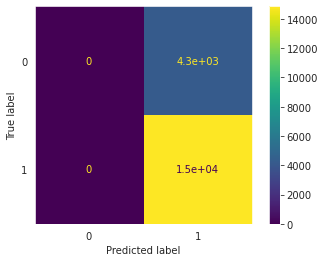

In [33]:
print("Accuracy Score: {}".format(accuracy_score(y_test, pred_test)))
print("Precision Score: {}".format(precision_score(y_test, pred_test)))
print("Recall Score: {}".format(recall_score(y_test, pred_test)))
print("F1 Score: {}".format(f1_score(y_test, pred_test)))
plot_confusion_matrix(rfc, X_test_sc, y_test)

In [34]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=12)
knn.fit(X_train_sc, y_train)
pred_test_knn = knn.predict(X_test_sc)

Accuracy Score: 0.7606068532566047
Precision Score: 0.7820597277119016
Recall Score: 0.959197414489631
F1 Score: 0.8616184831256803


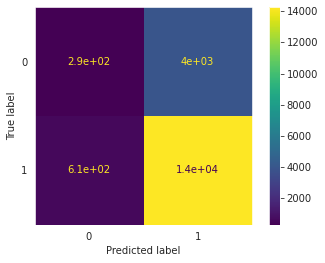

In [35]:
print("Accuracy Score: {}".format(accuracy_score(y_test, pred_test_knn)))
print("Precision Score: {}".format(precision_score(y_test, pred_test_knn)))
print("Recall Score: {}".format(recall_score(y_test, pred_test_knn)))
print("F1 Score: {}".format(f1_score(y_test, pred_test_knn)))
plot_confusion_matrix(knn, X_test_sc, y_test)

### Technique 2 - Random Forest & KNN with imblearn

In [36]:
from imblearn.under_sampling import RepeatedEditedNearestNeighbours
from collections import Counter
print('Original dataset shape %s' % Counter(y_train))
# smt = SMOTETomek(random_state=42)
renn = RepeatedEditedNearestNeighbours()
X_train_sc_res, y_train_res = renn.fit_resample(X_train_sc, y_train)
print('Resampled dataset shape %s' % Counter(y_train_res))

Using TensorFlow backend.
/home/gagandeep/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/gagandeep/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/gagandeep/.local/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/gagandeep/.local/lib/python3.6/site-packages/tenso

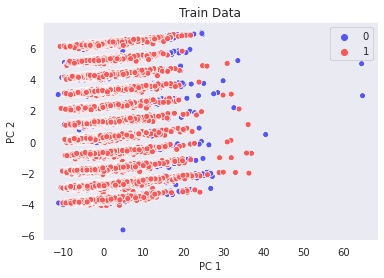

In [37]:
pca = PCA(n_components=2)
pca_train_res_df = pca.fit_transform(X_train_sc_res)
# pca_test_df = pca.fit_transform(X_test_sc)
sns.scatterplot(x=pca_train_res_df[:,0], y=pca_train_res_df[:,1], hue=y_train_res, palette='seismic').set(title='Train Data', xlabel="PC 1", ylabel = "PC 2")
plt.show()
# sns.scatterplot(x=pca_test_df[:,0], y=pca_test_df[:,1], hue=y_test, palette='seismic').set(title='Test Data', xlabel="PC 1", ylabel = "PC 2")
# plt.show()

In [38]:
rfc_res = RandomForestClassifier(random_state=42, max_depth=5)
rfc_res.fit(X_train_sc_res, y_train_res)
pred_test_res = rfc_res.predict(X_test_sc)

Accuracy Score: 0.7769814281977505
Precision Score: 0.7769814281977505
Recall Score: 1.0
F1 Score: 0.8744958341920099


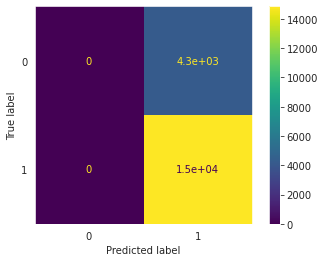

In [39]:
print("Accuracy Score: {}".format(accuracy_score(y_test, pred_test_res)))
print("Precision Score: {}".format(precision_score(y_test, pred_test_res)))
print("Recall Score: {}".format(recall_score(y_test, pred_test_res)))
print("F1 Score: {}".format(f1_score(y_test, pred_test_res)))
plot_confusion_matrix(rfc_res, X_test_sc, y_test)

In [40]:
from sklearn.neighbors import KNeighborsClassifier
knn_res = KNeighborsClassifier(n_neighbors=5)
knn_res.fit(X_train_sc_res, y_train_res)
pred_test_knn_res = knn_res.predict(X_test_sc)

Accuracy Score: 0.5734763274914988
Precision Score: 0.8184238045441582
Recall Score: 0.5796525720441691
F1 Score: 0.6786488510504118


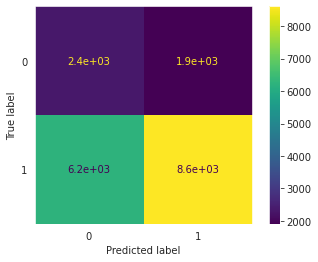

In [41]:
print("Accuracy Score: {}".format(accuracy_score(y_test, pred_test_knn_res)))
print("Precision Score: {}".format(precision_score(y_test, pred_test_knn_res)))
print("Recall Score: {}".format(recall_score(y_test, pred_test_knn_res)))
print("F1 Score: {}".format(f1_score(y_test, pred_test_knn_res)))
plot_confusion_matrix(knn_res, X_test_sc, y_test)

### The selected model was Technique 1 - Random Forest. We will know store the model, the label encoders and the standard scaler as pickle objects.

In [43]:
import pickle

# Objects to store
# Encoders
# Standard Scaler
# Model
SAVE_PATH = '/media/gagandeep/2E92405C92402AA3/Work/Codes/PythonCodes/BankLoanApp/Production/'
objs = [le_loan_status, le_term, le_home_ownership, le_purpose, oe_years_job, sc, selected_columns, selected_continous_cols, rfc]
objs_name = ["le_loan_status.pickle", "le_term.pickle", "le_home_ownership.pickle", "le_purpose.pickle", "oe_years_job.pickle", "standard_scaler.pickle",
            "selected_columns.pickle", "selected_continous_cols.pickle", "model_randomforestclassifier.pickle"]

for i in range(len(objs)):
    pickle_out = open(SAVE_PATH + objs_name[i], 'wb')
    pickle.dump(objs[i], pickle_out)
    pickle_out.close()
